# Spykshark decoding with Trodes data

### the purpose of the notebook is to utilize Dan Liu's spykshrk optimized decoder

Dan has only used nspike data, not Trodes data. 

I will start off by using Eric's lfdp file parsing, then create functions to reformat to spykshrk. 

In the future, I will need to create spykshrk file io from raw trodes functions.

step 0
go to spykshrk directory to use it as a module later

In [1]:
cd ~/Src/spykshrk_realtime/

/home/droumis/Src/spykshrk_realtime


## step 1 load trodes data with eric's lfdp



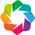

In [2]:
import loren_frank_data_processing as lfdp
# import replay_classification as replay
# import ripple_detection as ripple
import matplotlib.pyplot as plt
import holoviews as hv
# import inspect
# import os
import pandas as pd
import numpy as np
from ipywidgets import FloatProgress
from IPython.display import display
hv.notebook_extension('bokeh', 'matplotlib')
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [8]:
'atom %s' % lfdp.__file__

'atom /home/droumis/anaconda3/lib/python3.6/site-packages/loren_frank_data_processing/__init__.py'

In [12]:
from os import system

system('atom %s' % lfdp.multiunit.__file__)

0

### issue!!! unresolved but low priority
with ipywidgets? 

jupyter nbextension enable --sys-prefix --py widgetsnbextension

In [3]:
animal_id = 'JZ1'
day, epoch = [1, 2]
ripple_area = 'ca1'
mu_areas = ['ca1', 'mec']
animals = {
    'JZ1': lfdp.Animal(short_name='JZ1', directory='../Roumis_2018/Raw-Data/JZ1')}
date = 20161114
areas = ['ca1']
mark_variables = ['channel_1_max', 'channel_2_max', 'channel_3_max',
                  'channel_4_max']

In [4]:
epoch_index = ('JZ1', 1, 2)
ntrode_key = ('JZ1', 1, 2, 1)
# mu_filenames = lfdp.multiunit.get_multiunit_filename(tetrode_key, animals)


In [5]:
ntrode_df = lfdp.make_tetrode_dataframe(animals)
ntrode_keys = ntrode_df.xs(epoch_index, drop_level=False).index.values

In [6]:
epoch_index

('JZ1', 1, 2)

In [7]:
ca1_ntrode_keys_df = ntrode_df.xs(epoch_index, drop_level=False).query('area == "ca1"')

In [8]:
ca1_ntrode_keys = ca1_ntrode_keys_df.index.values

In [9]:
ca1_ntrode_keys

array([('JZ1', 1, 2, 16), ('JZ1', 1, 2, 17), ('JZ1', 1, 2, 18),
       ('JZ1', 1, 2, 19), ('JZ1', 1, 2, 20), ('JZ1', 1, 2, 21),
       ('JZ1', 1, 2, 22), ('JZ1', 1, 2, 23), ('JZ1', 1, 2, 24),
       ('JZ1', 1, 2, 25), ('JZ1', 1, 2, 26), ('JZ1', 1, 2, 27),
       ('JZ1', 1, 2, 28), ('JZ1', 1, 2, 29), ('JZ1', 1, 2, 30)],
      dtype=object)

In [10]:
position_variables = ['linear_distance', 'trajectory_direction', 'speed']
position_df = lfdp.get_interpolated_position_dataframe(epoch_index, animals)
position_df['time'] = position_df.index #add the time index values as another col

In [13]:
position_df

NameError: name 'position_df' is not defined

In [14]:
# %store position_df
%store -r position_df

In [15]:
position_df

,labeled_segments,from_well,to_well,task,is_correct,x_position,y_position,head_direction,speed,linear_distance,time
time,,,,,,,,,,,
00:28:00.085200,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.085200
00:28:00.085867,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.085867
00:28:00.086533,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.086533
00:28:00.087200,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.087200
00:28:00.087867,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.087867
00:28:00.088533,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.088533
00:28:00.089200,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.089200
00:28:00.089867,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.089867
00:28:00.090533,1.0,NaN,NaN,NaN,NaN,47.222953,51.47623,-3.077724,5.142901,42.241868,00:28:00.090533


### ISSUE!!! resolved
get_multiunit_dataframe is loading all spikes from a day.. why is it not respecting the epoch key

so it turns out that get_multiunit_dataframe is more of a helper function for get_multiunit_indicator_dataframe.. and that the epoch time filtering happens in the latter after the former is called

I'm fixing this by doing the filtering here after getting the epoch times separately

In [15]:
def get_trial_time(epoch_key, animals):
    tetrode_info = (
        lfdp.make_tetrode_dataframe(animals)
        .xs(epoch_key, drop_level=False))
    for tetrode_key in tetrode_info.index:
        lfp_df = lfdp.get_LFP_dataframe(tetrode_key, animals)
        if lfp_df is not None:
            break
    return lfp_df.index        

In [16]:
epoch_time = get_trial_time(epoch_index, animals)

In [ ]:
# # f = FloatProgress(min=0, max=ntrode_keys.shape[0])
# # f.value = 0
# # display(f)
mu_times = []
for key_num, ntrode_key in enumerate(ntrode_keys):
    mu_times.append(lfdp.multiunit.get_multiunit_dataframe(ntrode_key, animals).loc[epoch_time.min():epoch_time.max()])
# #     f.value += 1

In [17]:
# %store mu_times
%store -r mu_times

In [18]:
mu_times[0].head()

,channel_1_max,channel_2_max,channel_3_max,channel_4_max
time,,,,
00:28:00.210600,504.770874,457.895477,503.309692,414.536926
00:28:00.218100,622.246582,612.895630,683.409241,593.562683
00:28:00.223500,-189.530045,-67.272179,-80.218246,-128.011063
00:28:00.224900,670.930481,634.863586,739.206848,607.044678
00:28:00.235500,670.930481,634.863586,739.206848,607.044678


In [19]:
# %store # view stores vars

In [20]:
cd ~/Src/Roumis_2018/

/home/droumis/Src/Roumis_2018


In [21]:
# import ripple_detection as ripple

# hippocampus_lfps = lfdp.get_LFPs(ca1_ntrode_keys_df.index, animals)
# time = hippocampus_lfps.index
# sampling_frequency = 1500

# ripple_times = ripple.Kay_ripple_detector(
#         time, hippocampus_lfps.values, position_df.speed.values, sampling_frequency,
#         minimum_duration=pd.Timedelta(milliseconds=15), zscore_threshold=4)

In [22]:
# %store ripple_times
%store -r ripple_times

# step 2 create the functions to reformat to spykshrk encoder/decoder inputs


In [24]:
import src.converters as lfconvert

spyk_marks_df = lfconvert.multiunit_to_spykshrk(mu_times, ntrode_keys)

In [26]:
spyk_marks_df

c00  c01  c02  c03  c04  c05  c06  \
day epoch elec_grp_id timestamp time                                           
1   2     1           168021060 1680.2106  504  457  503  414  NaN  NaN  NaN   
                      168021810 1680.2181  622  612  683  593  NaN  NaN  NaN   
                      168022350 1680.2235 -189  -67  -80 -128  NaN  NaN  NaN   
                      168022490 1680.2249  670  634  739  607  NaN  NaN  NaN   
                      168023550 1680.2355  670  634  739  607  NaN  NaN  NaN   
                      168023650 1680.2365   51  173   25   31  NaN  NaN  NaN   
                      168024080 1680.2408  567  511  602  470  NaN  NaN  NaN   
                      168024300 1680.2430  504  457  503  414  NaN  NaN  NaN   
                      168024810 1680.2481   10   21  -55  151  NaN  NaN  NaN   
                      168024990 1680.2499  525  528  547  535  NaN  NaN  NaN   
                      168025830 1680.2583  670  634  739  607  NaN  NaN  NaN   
                      168027450 1680.2745 -100 -222  -76 -166  NaN  NaN  NaN   
                      168027560 1680.2756  504  457  503  414  NaN  NaN  NaN   
                      168027620 1680.2762  670  634  739  607  NaN  NaN  NaN   
                      168027630 1680.2763  -30 -175  -11 -112  NaN  NaN  NaN   
                      168029030 1680.2903  504  457  503  414  NaN  NaN  NaN   
                      168029500 1680.2950  670  634  739  607  NaN  NaN  NaN   
                      168030160 1680.3016  -57 -178  -21  -95  NaN  NaN  NaN   
                      168030610 1680.3061  504  457  503  414  NaN  NaN  NaN   
                      168030770 1680.3077  567  511  602  470  NaN  NaN  NaN   
                      168030910 1680.3091   16   -3  161   58  NaN  NaN  NaN   
                      168031450 1680.3145  516  501  512  475  NaN  NaN  NaN   
                      168031620 1680.3162  567  511  602  470  NaN  NaN  NaN   
                      168031790 1680.3179 -116 -122 -209  -78  NaN  NaN  NaN   
                      168031940 1680.3194  533  539  550  539  NaN  NaN  NaN   
                      168031950 1680.3195  504  457  503  414  NaN  NaN  NaN   
                      168034990 1680.3499   60  137   88  208  NaN  NaN  NaN   
                      168035870 1680.3587  525  528  547  535  NaN  NaN  NaN   
                      168036120 1680.3612  670  634  739  607  NaN  NaN  NaN   
                      168038410 1680.3841 -210 -275 -173 -188  NaN  NaN  NaN   
...                                        ...  ...  ...  ...  ...  ...  ...   
          30          289507110 2895.0711   16   60  -10    9  NaN  NaN  NaN   
                      289507120 2895.0712  153  216   59   44  NaN  NaN  NaN   
                      289507170 2895.0717  -26   22  -29  -39  NaN  NaN  NaN   
                      289507500 2895.0750   16   60  -10    9  NaN  NaN  NaN   
                      289507570 2895.0757  100  224  131   39  NaN  NaN  NaN   
                      289507590 2895.0759  -26   22  -29  -39  NaN  NaN  NaN   
                      289507690 2895.0769    2   44  -12    5  NaN  NaN  NaN   
                      289508130 2895.0813 -275 -209 -223 -138  NaN  NaN  NaN   
                      289508170 2895.0817   16   60  -10    9  NaN  NaN  NaN   
                      289508240 2895.0824   -1   40  -21  -10  NaN  NaN  NaN   
                      289508290 2895.0829  134  198  298  149  NaN  NaN  NaN   
                      289508610 2895.0861  -33   35  -27  -53  NaN  NaN  NaN   
                      289508990 2895.0899   16   60  -10    9  NaN  NaN  NaN   
                      289509010 2895.0901 -214 -304 -297 -192  NaN  NaN  NaN   
                      289509090 2895.0909   -1   40  -21  -10  NaN  NaN  NaN   
                      289510030 2895.1003  -26   22  -29  -39  NaN  NaN  NaN   
                      289510400 2895.1040   -2   63   73  171  NaN  NaN  NaN   
                      289510940 2895.1094  

In [27]:
spyk_linpos_df = lfconvert.linear_position_to_spykshrk(position_df, ntrode_key)

In [28]:
spyk_ripples_df = lfconvert.ripples_to_spykshrk(ripple_times, day=1, epoch=2)

# step 3 use spykshrk data_containers



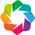

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [29]:
import pandas as pd
import numpy as np
import scipy as sp

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import patches
import json
import os
import scipy.signal
import functools
import holoviews as hv

from holoviews.operation.datashader import aggregate, shade, datashade, dynspread, regrid
from holoviews.operation import decimate

import math

# from spykshrk.util import AttrDict
import spykshrk.franklab.filterframework_util as ff_util

from spykshrk.realtime.simulator import nspike_data

from spykshrk.franklab.pp_decoder.util import gaussian, normal2D, apply_no_anim_boundary, simplify_pos_pandas, \
                                                normal_pdf_int_lookup
from spykshrk.franklab.pp_decoder.pp_clusterless import OfflinePPDecoder, OfflinePPEncoder
from spykshrk.franklab.pp_decoder.data_containers import EncodeSettings, DecodeSettings, SpikeObservation, \
                                                         LinearPosition, StimLockout, Posteriors, \
                                                         FlatLinearPosition, SpikeWaves, SpikeFeatures, \
                                                         pos_col_format, DayEpochTimeSeries

from spykshrk.franklab.pp_decoder.visualization import DecodeVisualizer
from spykshrk.franklab.pp_decoder.decode_error import LinearDecodeError

import dask
import dask.dataframe as dd
import dask.array as da

import cloudpickle
        
%load_ext Cython

%matplotlib inline

hv.extension('matplotlib')
hv.extension('bokeh')
#pd.set_option('float_format', '{:,.2f}'.format)
pd.set_option('display.precision', 4)
pd.set_option('display.max_rows', 10)
pd.set_option('display.max_columns', 15)
#pd.set_option('display.width', 80)

idx = pd.IndexSlice

matplotlib.rcParams.update({'font.size': 14})

%load_ext autoreload
%autoreload 2

hv.Store.renderers['bokeh'].webgl = False

In [31]:
try:
    cluster.close()
    client.close()
except:
    print("No cluster or client running")
    
from dask.distributed import Client, LocalCluster

# cluster = LocalCluster(n_workers=10)
client = Client()
client

# min_worker_memory = np.inf
# for w in cluster.workers:
#     min_worker_memory = min(min_worker_memory, w.memory_limit)

No cluster or client running


Client Scheduler: tcp://127.0.0.1:42489 Dashboard: http://127.0.0.1:8787/status,Cluster Workers: 16 Cores: 16 Memory: 135.18 GB


In [32]:
config_file = '/home/droumis/Src/spykshrk_realtime/config/droumis_test.json'
# config_file = '/home/droumis/Src/spykshrk_realtime/config/bond_single_derecho.json'
# config_file = '/home/droumis/Src/spykshrk_realtime/config/JZ1_derecho.json'
config = json.load(open(config_file, 'r'))
encode_settings = EncodeSettings(config)
encode_settings.arm_coordinates

[[0, 69], [150, 252], [300, 404]]

In [33]:

def get_all_below_threshold(self, threshold):
    ind = np.nonzero(np.all(self.values < threshold, axis=1))
    return self.iloc[ind]

def get_any_above_threshold(self, threshold):
    ind = np.nonzero(np.any(self.values > threshold, axis=1))
    return self.iloc[ind]

def get_all_above_threshold(self, threshold):
    ind = np.nonzero(np.all(self.values > threshold, axis=1))
    return self.iloc[ind]


In [36]:
ca1_spyks = spyk_marks_df[
    spyk_marks_df.index.get_level_values(
        'elec_grp_id').isin(
        ca1_ntrode_keys_df.index.get_level_values(
            level='tetrode_number'))
].loc[:,'c00':'c03']

In [38]:
spk_marks = SpikeFeatures.create_default(ca1_spyks, sampling_rate=1e5)
spk_marks = get_all_above_threshold(spk_marks, 0)
spk_marks = get_any_above_threshold(spk_marks, 400)
spk_marks = get_all_below_threshold(spk_marks, 2000)

In [39]:
spk_pos = FlatLinearPosition.create_default(
        spyk_linpos_df, sampling_rate=1e5, arm_coord=encode_settings.arm_coordinates
    )

In [40]:
spyk_ripples_df.index.set_levels(
    levels = range(0, len(spyk_ripples_df)),
    level='event', inplace=True)

In [41]:
spyk_ripples_df

starttime  endtime  maxthresh
day epoch event time                                  
1   2     0     1,687.1    1,687.1  1,687.1          4
          1     1,689.4    1,689.4  1,689.5          4
          2     1,693.2    1,693.2  1,693.2          4
          3     1,694.9    1,694.9  1,695.0          4
          4     1,696.9    1,696.9  1,697.0          4
...                            ...      ...        ...
          155   2,830.2    2,830.2  2,830.3          4
          156   2,846.6    2,846.6  2,846.7          4
          157   2,855.2    2,855.2  2,855.3          4
          158   2,859.9    2,859.9  2,860.0          4
          159   2,864.4    2,864.4  2,864.5          4

[160 rows x 3 columns]

In [42]:
from spykshrk.franklab.pp_decoder.data_containers import RippleTimes
shrk_rips = RippleTimes.create_default(spyk_ripples_df, time_unit=1e5)

In [ ]:
# position_nonan = oneDlinpos[oneDlinpos.all(axis=1)]
# position_nonan = position_nonan.astype('int')


# encoding/decoding with dask
create encode settings and run spykshrk encoder

In [44]:
ca1_spyks

c00  c01  c02   c03
day epoch elec_grp_id timestamp time                        
1   2     16          168008520 1,680.1 -713 -687 -715 -1684
                      168009600 1,680.1 -487 -514 -652 -1302
                      168011430 1,680.1 -275 -176 -232  -808
                      168011870 1,680.1  -57 -151 -132  -123
                      168013920 1,680.1 -487 -514 -652 -1302
...                                      ...  ...  ...   ...
          30          289513300 2,895.1  181  182  306    66
                      289513310 2,895.1  -33   35  -27   -53
                      289513490 2,895.1    2   44  -12     5
                      289513570 2,895.1  149   28   -8   -30
                      289514340 2,895.1    2   44  -12     5

[4184605 rows x 4 columns]

In [43]:
spk_marks

<NewCls: a25f5ff4-13c7-4f09-948a-4f83d8c50699, shape: ((33917, 4))>

In [30]:
encoder = OfflinePPEncoder(linflat=spk_pos, spk_amp=spk_marks, speed_thresh=0, dask_chunksize=1000,
                           encode_settings=encode_settings)

In [43]:
# %%prun -r -s cumulative
encoder_results = encoder.run_encoder()

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.39s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.58s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.55s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.55s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 3.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.80s.  This is often caused by long-running GIL-holding functions or moving large chu

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.80s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.81s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.75s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.75s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 3.75s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.75s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.75s.  This is often caused by long-running GIL-holding functions or moving large chu

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.35s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.79s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.79s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.79s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.79s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.95s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.95s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.95s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.95s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.95s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 3.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.77s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.77s.  This is often caused by long-running GIL-holding functions or moving large chu

distributed.core - WARNING - Event loop was unresponsive in Nanny for 17.38s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 17.55s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 17.30s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 17.82s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 17.55s.  This is often caused by long-running GIL-holding functions or moving large ch

distributed.core - WARNING - Event loop was unresponsive in Nanny for 11.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 11.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 11.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 11.81s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 6.97s.  This is often caused by long-running GIL-holding functions or moving large chu

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.91s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.91s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.91s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.91s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.91s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.24s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.24s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.24s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.24s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.24s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.40s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.40s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 1.40s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.40s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.40s.  This is often caused by long-running GIL-holding functions or moving large chu

distributed.nanny - WARNING - Worker exceeded 95% memory budget.  Restarting
tornado.application - ERROR - Exception in callback <bound method Nanny.memory_monitor of <Nanny: tcp://127.0.0.1:44831, threads: 1>>
Traceback (most recent call last):
  File "/home/droumis/anaconda3/lib/python3.6/site-packages/tornado/ioloop.py", line 1026, in _run
    return self.callback()
  File "/home/droumis/anaconda3/lib/python3.6/site-packages/distributed/nanny.py", line 258, in memory_monitor
    self.process.process.terminate()
AttributeError: 'NoneType' object has no attribute 'terminate'
distributed.nanny - WARNING - Restarting worker
distributed.client - WARNING - Couldn't gather keys {"('compute_observ_tet-bf7c85df3fbbe56f37e7fb6799866a22', 0)": [], "('compute_observ_tet-e7bc6e9c49169dc40733206859e4846b', 17)": [], "('compute_observ_tet-e7bc6e9c49169dc40733206859e4846b', 14)": []}


In [11]:
# %store encoder_results
%store -r encoder_results

In [14]:
encoder_results

AttributeError: 'tuple' object has no attribute 'spk_amp'

## get encoding results into decoder friendly input df
1. concat across ntrodes and set ntrode col
2. set multiindex
3. append position 

In [32]:
observ = []
observ_obj = []
observ_tet_list = []

tet_ids = np.unique(spk_marks.index.get_level_values('elec_grp_id'))
observ_tet_list = []
grp = spk_marks.groupby('elec_grp_id')

for tet_ii, (tet_id, grp_spk) in enumerate(grp):
    tet_result = encoder_results[tet_ii]
    tet_result.set_index(grp_spk.index, inplace=True)
    observ_tet_list.append(tet_result)

observ = pd.concat(observ_tet_list)
observ_obj = SpikeObservation(observ.sort_index(level=['day', 'epoch', 
                                                               'timestamp', 'elec_grp_id']), )

observ_obj['elec_grp_id'] = observ_obj.index.get_level_values('elec_grp_id')
observ_obj.index = observ_obj.index.droplevel('elec_grp_id')
observ_obj['position'] = encoder.linflat.get_irregular_resampled(
    observ_obj.index.get_level_values('timestamp')
).get_mapped_single_axis().set_index(observ_obj.index)['linpos_flat']

# Decode

In [33]:
# %%prun -r -s cumulative

# Run PP decoding algorithm
time_bin_size = 30
decode_settings = DecodeSettings(config)
decoder = OfflinePPDecoder(lin_obj=encoder.linflat, observ_obj=observ_obj,
                           encode_settings=encode_settings, decode_settings=decode_settings, 
                           which_trans_mat='simple', time_bin_size=time_bin_size, dask_chunksize=1000)

# %%prun -r -s cumulative
posteriors = decoder.run_decoder()

Beginning likelihood calculation


distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.53s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.54s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.54s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.54s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.54s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.88s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.88s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.88s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.88s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.88s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.98s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.98s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.98s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.98s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.98s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.44s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.44s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.06s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.54s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.89s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 4.53s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 4.53s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 4.53s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 4.53s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 4.53s.  This is often caused by long-running GIL-holding functions or moving large chunks 

Beginning posterior calculation


distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.47s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.47s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.48s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.48s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.48s.  This is often caused by long-running GIL-holding functions or moving large chunks 

# Depricated Alternate method of Encoding without dask

In [306]:
# results, spikes, positions = no_dask_run_encoder(encoder)

distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 21% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 22% CPU time recently (threshold: 10%)
distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.64s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 2.13s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.utils_perf - WARNING - full garbage collecti

distributed.core - WARNING - Event loop was unresponsive in Nanny for 1.11s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 1.11s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.utils_perf - WARNING - full garbage collections took 50% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 50% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 50% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 47% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 50% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collecti

In [305]:
# def no_dask_run_encoder(encoder):
#     grp = encoder.spk_amp.groupby('elec_grp_id')
#     results = []
#     spikes = []
#     positions = []
#     for tet_id, spk_tet in grp:
#         spk_tet.index = spk_tet.index.droplevel('elec_grp_id')
#         tet_lin_pos = encoder.linflat.get_irregular_resampled(
#             spk_tet.index.get_level_values('timestamp')
#         ).get_mapped_single_axis()
# #         goodpos_ind = tet_lin_pos.all(axis=1).values
# #         tet_lin_pos_thresh = tet_lin_pos[goodpos_ind]
# #         spk_tet = spk_tet[goodpos_ind]
# #         nodask_spk_tet = spk_tet.get_simple_index()
#         results.append(nodask_compute_observ_tet(
#             dec_spk=spk_tet,
#             enc_spk=spk_tet.get_simple_index(),
#             tet_lin_pos=tet_lin_pos,
#             occupancy=encoder.occupancy,
#             encode_settings=encoder.encode_settings))
#         spikes.append(spk_tet)
#         positions.append(tet_lin_pos.set_index(spk_tet.index))
#     return results, spikes, positions
# def nodask_compute_observ_tet(dec_spk, enc_spk, tet_lin_pos, occupancy, encode_settings):
#     pos_distrib_tet = sp.stats.norm.pdf(np.expand_dims(encode_settings.pos_bins, 0),
#                                         np.expand_dims(tet_lin_pos['linpos_flat'], 1),
#                                         encode_settings.pos_kernel_std)
#     mark_contrib = nodask_normal_pdf_int_lookup(np.expand_dims(dec_spk, 1),
#                                          np.expand_dims(enc_spk, 0),
#                                          encode_settings.mark_kernel_std)
#     all_contrib = np.prod(mark_contrib, axis=2)
#     del mark_contrib
#     observ = np.matmul(all_contrib, pos_distrib_tet)
#     del all_contrib
#     # occupancy normalize
#     observ = observ / (occupancy + 1e-10)
#     # normalize each row
#     observ_sum = observ.sum(axis=1)
#     observ_sum_zero = observ_sum == 0
#     observ[observ_sum_zero, :] = 1/(encode_settings.pos_bins[-1] - encode_settings.pos_bins[0])
#     observ_sum[observ_sum_zero] = 1
#     observ = observ / observ.sum(axis=1)[:, np.newaxis]
#     ret_df = pd.DataFrame(observ, index=dec_spk.index,
#                           columns=[pos_col_format(pos_ii, observ.shape[1])
#                                    for pos_ii in range(observ.shape[1])])
#     return ret_df
# def nodask_normal_pdf_int_lookup(x, mean, std):
#     max_amp = 2000
#     norm_dist = sp.stats.norm.pdf(x=np.arange(-max_amp,max_amp), loc=0, scale=std)
# #     mean = mean.astype('int')
# #     print(x-mean+max_amp)
#     return norm_dist[x-mean+max_amp]

# Viz

** need to add a ripple_grp column to the posteriors df to get rip data
- riptimes is a RippleTimes instance
    - use RippleTimes.create_default(df)



- plot_all_dynamic is dynamic map of plot_all with hv.streams.RangeXY() of time
    - dec_viz.plot_all plots posterior, pos, armbounds, if*ripples*, at timeX
        - plot_linear_pos (hv.Points)
        - plot_arm_boundaries  (hv.Curve)
        - highlight_ripples (hv.Polygons)
        - plot_decode_image (shaded extent of post_img (hv.Image))
            - dec_viz.post_img is the entire posterior image
                - hc.Image
    
- plot_ripple_dynamic is dmap of plot_ripple_all with rip_ind kdims
    - plot_ripple_all(self, rip_ind)
        - plot_arm_boundaries
        - plot_ripple_linflat
        - plot_ripple(rip_ind)
            - posteriors.query by ripple_grp
                - in __init__ posteriors.apply_time_event(riptimes, event_mask_name='ripple_grp')

In [47]:
test = posteriors.iloc[600000:610000]

In [67]:

time_dim_name = 'time (s)'
pos_dim_name = 'linpos (cm)'
val_dim_name = 'probability'
post_img = hv.Image(np.flip(test.get_distribution_view().values.T, axis=0),
                         bounds=(test.get_time_start(), test.get_pos_start(),
                                 test.get_time_end(),
                                 test.get_pos_end()),
                         kdims=[time_dim_name, pos_dim_name], vdims=[val_dim_name])

In [68]:
post_img = post_img.redim(probability={'range': (0, 0.3)})

In [70]:
rgb = shade(regrid(post_img, aggregator='mean', dynamic=False), cmap=plt.get_cmap('hot'),
            normalization='linear', dynamic=False)

In [109]:
dec_viz = DecodeVisualizer(
    posteriors, linpos=encoder.linflat, enc_settings=encode_settings, riptimes=shrk_rips)

In [86]:
decoder.posteriors.query('ripple_grp == 100')

x000  x001  x002  x003  x004  x005  x006     ...      x446  x447  x448  x449  \
day epoch timestamp     time                                                  ...                               
1   2     237,144,060.0 2,371.4   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,144,090.0 2,371.4   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,144,120.0 2,371.4   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,144,150.0 2,371.4   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,144,180.0 2,371.4   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
...                               ...   ...   ...   ...   ...   ...   ...     ...       ...   ...   ...   ...   
          237,150,660.0 2,371.5   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,150,690.0 2,371.5   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,150,720.0 2,371.5   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,150,750.0 2,371.5   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   
          237,150,780.0 2,371.5   0.0   0.0   0.0   0.0   0.0   0.0   0.0     ...       0.0   0.0   0.0   0.0   

                                 num_spikes     dec_bin  ripple_grp  
day epoch timestamp     time                                         
1   2     237,144,060.0 2,371.4         0.0 2,304,344.0         100  
          237,144,090.0 2,371.4         0.0 2,304,345.0         100  
          237,144,120.0 2,371.4         0.0 2,304,346.0         100  
          237,144,150.0 2,371.4         0.0 2,304,347.0         100  
          237,144,180.0 2,371.4         0.0 2,304,348.0         100  
...                                     ...         ...         ...  
          237,150,660.0 2,371.5         0.0 2,304,564.0         100  
          237,150,690.0 2,371.5         0.0 2,304,565.0         100  
          237,150,720.0 2,371.5         0.0 2,304,566.0         100  
          237,150,750.0 2,371.5         0.0 2,304,567.0         100  
          237,150,780.0 2,371.5         0.0 2,304,568.0         100  

[225 rows x 453 columns]

In [89]:
dec_viz.riptimes.get_num_events()

160

In [103]:
(np.unique(dec_viz.posteriors['ripple_grp']))

array([ -1,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160])

In [110]:
%%output backend='bokeh' size=400 holomap='scrubber'
%%opts RGB { +framewise} [height=100 width=250 colorbar=True]
%%opts Points {+framewise} [height=100 width=250] (marker='*' size=4 alpha=0.5)
%%opts Polygons (color='grey', alpha=0.5 fill_color='grey' fill_alpha=0.3)
dec_viz.plot_ripple_dynamic()

:DynamicMap   [rip_ind]

In [73]:
from holoviews import Store
from bokeh.models.arrow_heads import TeeHead
Store.add_style_opts(hv.ErrorBars, ['upper_head', 'lower_head'], backend='bokeh')
Store.add_style_opts(hv.ErrorBars, ['ecolor'], backend='matplotlib')


In [ ]:
%%output backend='bokeh' size=400 holomap='scrubber'
%%opts RGB { +framewise} [height=100 width=250 colorbar=True]
%%opts Points {+framewise} [height=100 width=250] (marker='o' size=4)
%%opts Polygons (color='grey', fill_color='grey')
dec_viz.plot_all_dynamic(stream=hv.streams.RangeXY(), plt_range=10, slide=10)

In [79]:
dec_viz.plot_all_dynamic(stream=hv.streams.RangeXY(), plt_range=10, slide=10)

:DynamicMap   [time]

In [80]:
dec_est_pos = posteriors.get_distribution_view().idxmax(axis=1).apply(lambda x: int(x[1:])).to_frame()
dec_est_pos.columns = ['est_pos']

dec_est_pos = FlatLinearPosition.create_default(dec_est_pos, encode_settings.sampling_rate,
                                                encode_settings.arm_coordinates, parent=posteriors)

resamp_lin_obj = encoder.linflat.get_resampled(time_bin_size).get_pd_no_multiindex()

error_obj = LinearDecodeError()

error_table = error_obj.calc_error_table(resamp_lin_obj, dec_est_pos,
                                         encode_settings.arm_coordinates, 2)

print(error_table.loc[:, idx[:, 'abs_error']].median())
print(error_table.loc[:, idx[:, 'abs_error']].mean())

decoder deleting


distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.59s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.59s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.59s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.59s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 2.59s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.22s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.22s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.22s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.22s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 5.22s.  This is often caused by long-running GIL-holding functions or moving large chunks 

distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.84s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.84s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Scheduler for 3.84s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.52s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
distributed.core - WARNING - Event loop was unresponsive in Nanny for 3.52s.  This is often caused by long-running GIL-holding functions or moving large chu

TypeError: 'NoneType' object is not iterable

In [81]:
%%output backend='bokeh' size=400 holomap='scrubber'
%%opts Points {+framewise} [height=100 width=250 aspect=2] (color=Cycle(values=['#FF0099', '#99FF00', '#5555FF']))
%%opts ErrorBars {+framewise} [height=100 width=250 aspect=2 ] (ecolor=Cycle(values=['#FF0099', '#99FF00', '#5555FF']) alpha=0.5 line_width=1 upper_head=TeeHead(size=0) lower_head=TeeHead(size=0))

err_viz = DecodeErrorVisualizer(error_table)

dmap = err_viz.plot_arms_error_dmap(slide_interval=10, plot_interval=10)

dmap

NameError: name 'DecodeErrorVisualizer' is not defined

In [ ]:
# %%time
# # Load merged rec HDF store based on config

# #config_file = '/opt/data36/daliu/realtime/spykshrk/ripple_dec/bond.config.json'
# #config_file = '/opt/data36/daliu/realtime/spykshrk/dec_60uv/bond.config.json'
# config_file = '/home/daliu/Src/spykshrk_realtime/config/bond_single.json'
# config = json.load(open(config_file, 'r'))

# day = config['simulator']['nspike_animal_info']['days'][0]
# epoch = config['simulator']['nspike_animal_info']['epochs'][0]
# time_bin_size = config['pp_decoder']['bin_size']

# # Main hdf5 data source file name
# hdf_file = os.path.join(config['files']['output_dir'],
#                         '{}.rec_merged.h5'.format(config['files']['prefix']))

# # Extract just encode and decode settings from config
# encode_settings = EncodeSettings(config)
# decode_settings = DecodeSettings(config)

# # Open data file
# store = pd.HDFStore(hdf_file, mode='r')

# # Encapsulate Spike Observation panda table in container
# observ_obj = SpikeObservation.from_realtime(store['rec_3'], day=day, epoch=epoch, enc_settings=encode_settings)

# # Grab stimulation lockout times
# stim_lockout = StimLockout.from_realtime(store['rec_11'], enc_settings=encode_settings)

# # Grab animal linearized real position
# nspike_anim = nspike_data.AnimalInfo(**config['simulator']['nspike_animal_info'])
# pos = nspike_data.PosMatDataStream(nspike_anim)
# pos_data = pos.data

# # Encapsulate linear position
# lin_obj = LinearPosition.from_nspike_posmat(pos_data, encode_settings)

# ripcons = nspike_data.RipplesConsData(nspike_anim)
# ripdata = ripcons.data_obj

In [ ]:
# spk_tet = spk_tet.get_simple_index()

# mark_contrib = nodask_normal_pdf_int_lookup(np.expand_dims(spk_tet, 1), np.expand_dims(spk_tet, 1), 3)

# all_contrib = np.prod(mark_contrib, axis=2)

# encode_settings.pos_kernel_std

# a = sp.stats.norm.pdf(np.expand_dims([1,2,3], 0), np.expand_dims([2, 6, 6], 1))

# norm_dist = sp.stats.norm.pdf(x=np.arange(-2,2), loc=0, scale=5)

# norm_dist

# tet_lin_pos = (encoder.linflat.get_irregular_resampled(spk_tet.index.get_level_values('timestamp'))
#                .get_mapped_single_axis())

# tet_lin_pos.plot()

# pos_distrib_tet = sp.stats.norm.pdf(np.expand_dims(encode_settings.pos_bins, 0),
#                                         np.expand_dims(tet_lin_pos['linpos_flat'], 1),
#                                         encode_settings.pos_kernel_std)

# np.expand_dims(tet_lin_pos['linpos_flat'], 1)

# encode_settings.pos_bins

# sp.stats.norm.pdf(5, 3, 2)

# observ = np.matmul(all_contrib, pos_distrib_tet)

# norm_dist = pd.DataFrame(norm_dist)

# norm_dist.describe()

# spk_tet2 = spk_tet.dropna(axis=1, how='any')

# nodask_spk_tet = spk_tet.get_simple_index()

# nodask_spk_tet.dropna(axis=0)

# sum(spk_tet.all(axis=1).values)

# spk_tet[spk_tet.isnull().any()]

# tet_lin_pos.index == spk_tet.index

# # Velocity threshold on spikes and position
# tet_lin_pos_thresh = tet_lin_pos.get_above_velocity(encoder.speed_thresh)

# tet_lin_pos_thresh

# spk_tet_thresh = spk_tet.reindex(tet_lin_pos_thresh.index)

# spk_tet.reindex(tet_lin_pos_thresh.index)

# new_times = np.round(spk_tet.index.get_level_values('time'), 5)
# new_times = (pd.MultiIndex.from_arrays([new_times]))
# spk_tet.index.set_levels(level='time', levels=(new_times), inplace=True)


# len(np.round(spk_tet.index.get_level_values('time'), 5))

# test1 = spk_tet.iloc[0:9]
# test2 = tet_lin_pos_thresh.iloc[0:9]
# result1 = test1.reindex(test2.index, method='bfill')
# display(test1.index.get_level_values('time') == test2.index.get_level_values('time'))
# display(result1)



# tet_lin_pos.index.get_level_values('time')

# spk_tet.index.get_level_values('time')



# max_amp = 2000
# norm_dist = sp.stats.norm.pdf(x=np.arange(-max_amp,max_amp), loc=0, scale=encode_settings.mark_kernel_std)

# plt.plot(norm_dist)



# d = oneDlinpos.get_irregular_resampled(spikes_thresh_int.index.get_level_values('timestamp'))



# x

# mean

# max_amp

# a = x-mean+max_amp

# plt.plot(a)